# Import packages

In [2]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>")) #Set scaling for the jupyter notebook cell width - make them bigger

/tmp/ipykernel_3331/3983057131.py:1: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display, HTML


In [3]:
#General packages
from IPython.display import clear_output #import of a single funtcion
import sys #system related packages
import os #better path and file handling
import pickle #saving and loading objects

#Tables, numbers etc
import pandas as pd #tables
import numpy as np #arrays
import scipy #sciency functions
from sklearn import mixture #For gaussian mixture model

#Plotting packages
import matplotlib.pyplot as plt #Main plotting
from matplotlib.ticker import MaxNLocator
from matplotlib.lines import Line2D
import seaborn as sbn #nicer plots

#RNA-seq analysis
import scanpy as sc #Main package for scRNA-seq analysis
import scanpy.external as sce #some more functions for scanpy
import bbknn #batch correction

from adjustText import adjust_text

root = '/mnt/c' if 'mnt' in os.getcwd() else 'C:' #root path depending on which environment I use

#Import some custom helper functions for plotting
path_skin_scripts = '{}/Users/User/Karl/Python/Projects'.format(root)
sys.path.append(path_skin_scripts)
from Skin_scripts import *

In [4]:
cell_cycle_genes_path = '{}/Users/User/Karl/Python/Projects/regev_lab_cell_cycle_genes.txt'.format(root)

cell_cycle_genes = [x.strip().title() for x in open(cell_cycle_genes_path)]

# Separate dataset for S-phase or G2M-phase associated genes
s_genes = [x for x in cell_cycle_genes[:43]]
g2m_genes = [x for x in cell_cycle_genes[43:]]

In [5]:
#path = '/mnt/c/Users/User/Desktop/To Be Deleted/Delete me!/Sara_seq_raw_loom/Processed'
path = '/mnt/e/IMPORTANT-Backup-Sequencing-Projects/2021-Greco-Sara-Nur-Help/Rebuttal_2022_Analysis'

In [6]:
os.listdir(os.path.join(path, 'Processed'))

['HMU_filtered_integrated_annotated.loom',
 'HMW_filtered_integrated_annotated.loom',
 'WTMU_filtered_integrated_annotated.loom',
 'WTMW_filtered_integrated_annotated.loom']

# Read in datasets

In [7]:
adatas = {}
for file in os.listdir(os.path.join(path, 'Processed')):
    adatas[file.split('_')[0]] = sc.read_loom(os.path.join(os.path.join(path, 'Processed', file)), validate = False)

In [8]:
adatas

{'HMU': AnnData object with n_obs × n_vars = 15397 × 13669
     obs: 'Commitment', 'G2M_score', 'GFP_class', 'Immune', 'Immune21', 'Infu', 'Infundibulum1', 'Krt6a_class', 'Krt6b_class', 'Location', 'RBC1', 'RNA_snn_res.0.1', 'S_score', 'Stress', 'Tomato_class', 'binned_delamination', 'dpt_ordered', 'dpt_pseudotime', 'dpt_reordered', 'imm_score', 'infu_score', 'integrated_snn_res.0.1', 'leiden', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'log1p_total_counts_hemo', 'log1p_total_counts_mito', 'log1p_total_counts_ribo', 'nCount_RNA', 'nFeature_RNA', 'n_genes_by_counts', 'orig.ident', 'pct_counts_hemo', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'pct_counts_in_top_50_genes', 'pct_counts_mito', 'pct_counts_ribo', 'percent.mt', 'phase', 'seurat_clusters', 'stress_score', 'total_counts', 'total_counts_hemo', 'total_counts_mito', 'total_counts_ribo', 'umap_density_GFP_class', 'umap_density_Tomato_class', 'umap_ingest_density_GFP_class', 'u

In [9]:
for adata in adatas.values():
    adata.var_names_make_unique()

In [10]:
adata = sc.concat(adatas.values(), keys = adatas.keys(), index_unique = '_', join = 'outer')

In [11]:
adata

AnnData object with n_obs × n_vars = 63069 × 14716
    obs: 'Commitment', 'G2M_score', 'GFP_class', 'Immune', 'Immune21', 'Infu', 'Infundibulum1', 'Krt6a_class', 'Krt6b_class', 'Location', 'RBC1', 'RNA_snn_res.0.1', 'S_score', 'Stress', 'Tomato_class', 'binned_delamination', 'dpt_ordered', 'dpt_pseudotime', 'dpt_reordered', 'imm_score', 'infu_score', 'integrated_snn_res.0.1', 'leiden', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'log1p_total_counts_hemo', 'log1p_total_counts_mito', 'log1p_total_counts_ribo', 'nCount_RNA', 'nFeature_RNA', 'n_genes_by_counts', 'orig.ident', 'pct_counts_hemo', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'pct_counts_in_top_50_genes', 'pct_counts_mito', 'pct_counts_ribo', 'percent.mt', 'phase', 'seurat_clusters', 'stress_score', 'total_counts', 'total_counts_hemo', 'total_counts_mito', 'total_counts_ribo', 'umap_density_GFP_class', 'umap_density_Tomato_class', 'umap_ingest_density_GFP_class', 'umap_inges

# Save combined datasets

In [12]:
path = '/mnt/e/IMPORTANT-Backup-Sequencing-Projects/2021-Greco-Sara-Nur-Help/Rebuttal_2022_Analysis'
adata = sc.read_loom(os.path.join(path, 'IFE_Combined_datasets.loom'), validate = False)

In [13]:
adata

AnnData object with n_obs × n_vars = 63069 × 14716
    obs: 'Commitment', 'G2M_score', 'GFP_class', 'Immune', 'Immune21', 'Infu', 'Infundibulum1', 'Krt6_class', 'Krt6a_class', 'Krt6b_class', 'Location', 'RBC1', 'RNA_snn_res.0.1', 'S_score', 'Stress', 'Tomato_class', 'Wound', 'binned_delamination', 'dpt_ordered', 'dpt_pseudotime', 'dpt_reordered', 'imm_score', 'infu_score', 'integrated_snn_res.0.1', 'leiden', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'log1p_total_counts_hemo', 'log1p_total_counts_mito', 'log1p_total_counts_ribo', 'nCount_RNA', 'nFeature_RNA', 'n_genes_by_counts', 'orig.ident', 'pct_counts_hemo', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'pct_counts_in_top_50_genes', 'pct_counts_mito', 'pct_counts_ribo', 'percent.mt', 'phase', 'seurat_clusters', 'stress_score', 'tdt_info', 'total_counts', 'total_counts_hemo', 'total_counts_mito', 'total_counts_ribo', 'umap_density_GFP_class', 'umap_density_Tomato_class', 'umap_ing

# Continue

In [14]:
adata.obs['geno'] = np.where(adata.obs['orig.ident'].str.startswith('H'), 'Hras', 'WT')
adata.obs['induction'] = np.where(adata.obs['orig.ident'].str.contains('M'), 'Mosaic', 'Full')
adata.obs['injury'] = np.where(adata.obs['orig.ident'].str.contains('U'), 'Uninjured', 'Injured')

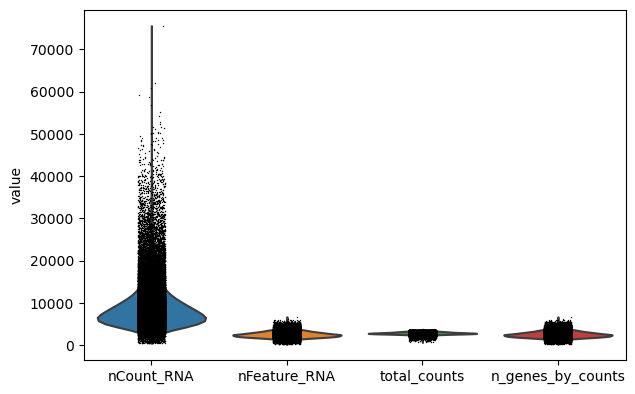

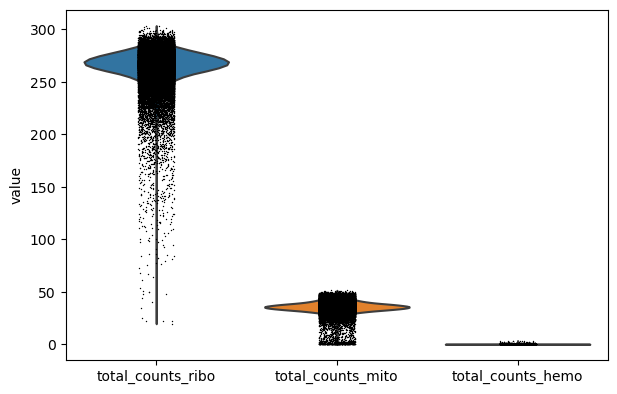

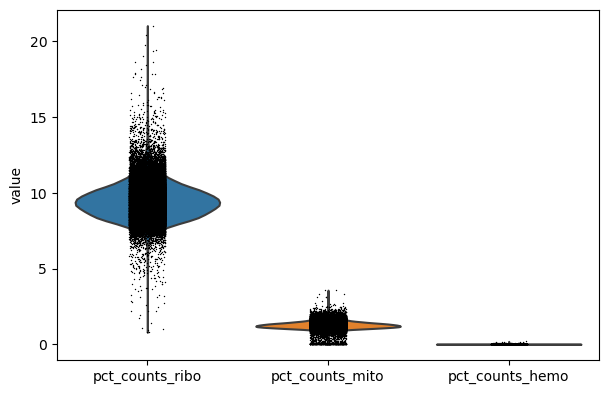

In [15]:
sc.pl.violin(adata, keys = ['nCount_RNA','nFeature_RNA', 'total_counts', 'n_genes_by_counts'])
sc.pl.violin(adata, keys = ['total_counts_ribo','total_counts_mito', 'total_counts_hemo'])
sc.pl.violin(adata, keys = ['pct_counts_ribo','pct_counts_mito', 'pct_counts_hemo'])

In [16]:
#adata.layers['scaled'] = adata.X.copy()
adata.X = adata.layers['counts'].copy()

In [17]:
adata

AnnData object with n_obs × n_vars = 63069 × 14716
    obs: 'Commitment', 'G2M_score', 'GFP_class', 'Immune', 'Immune21', 'Infu', 'Infundibulum1', 'Krt6_class', 'Krt6a_class', 'Krt6b_class', 'Location', 'RBC1', 'RNA_snn_res.0.1', 'S_score', 'Stress', 'Tomato_class', 'Wound', 'binned_delamination', 'dpt_ordered', 'dpt_pseudotime', 'dpt_reordered', 'imm_score', 'infu_score', 'integrated_snn_res.0.1', 'leiden', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'log1p_total_counts_hemo', 'log1p_total_counts_mito', 'log1p_total_counts_ribo', 'nCount_RNA', 'nFeature_RNA', 'n_genes_by_counts', 'orig.ident', 'pct_counts_hemo', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'pct_counts_in_top_50_genes', 'pct_counts_mito', 'pct_counts_ribo', 'percent.mt', 'phase', 'seurat_clusters', 'stress_score', 'tdt_info', 'total_counts', 'total_counts_hemo', 'total_counts_mito', 'total_counts_ribo', 'umap_density_GFP_class', 'umap_density_Tomato_class', 'umap_ing

In [18]:
sc.pp.normalize_total(adata)
sc.pp.log1p(adata)

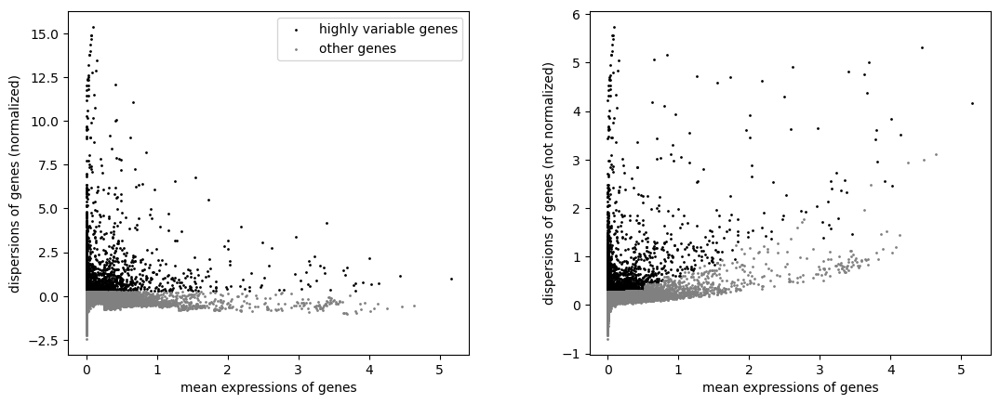

In [19]:
sc.pp.highly_variable_genes(adata, n_top_genes = 2000)
sc.pl.highly_variable_genes(adata)

In [20]:
sc.pp.pca(adata)
#sc.pp.neighbors(adata)
bbknn.bbknn(adata, batch_key='orig.ident')
sc.tl.umap(adata)

In [21]:
sample = {'HMU': 'HMU',
          'HM5U': 'HMU', 
          'HM12U': 'HMU',
          'HM5W': 'HMW',
          'HM12W': 'HMW', 
          'HMW': 'HMW', 
          'WTM3U': 'WTMU', 
          'WTM11U': 'WTMU', 
          'WTM13U': 'WTMU',
          'WTMW3W': 'WTMW', 
          'WTMW11W': 'WTMW', 
          'WTMW13W': 'WTMW'}
adata.obs['batch'] = adata.obs['orig.ident'].map(sample)

replicate = {'HMU': 'Mouse1',
             'HM5U': 'Mouse2', 
             'HM12U': 'Mouse3',
             'HMW': 'Mouse1',
             'HM5W': 'Mouse2', 
             'HM12W': 'Mouse3', 
             'WTM3U': 'Mouse1', 
             'WTM11U': 'Mouse2', 
             'WTM13U': 'Mouse3',
             'WTMW3W': 'Mouse1', 
             'WTMW11W': 'Mouse2', 
             'WTMW13W': 'Mouse3'}
adata.obs['Replicate'] = adata.obs['orig.ident'].map(replicate)

## Keep the cluster annotation from individual samples

In [22]:
adata.obs['leiden_old'] = adata.obs['leiden'].copy()

In [23]:
#Use HMW sample as landmarks
hmw_data = adata[adata.obs['batch']=='HMW'].copy()
adata.obs['leiden_comb'] = sc.tl.ingest(adata, adata_ref = hmw_data, obs = ['leiden_old'], inplace = False).obs['leiden_old']

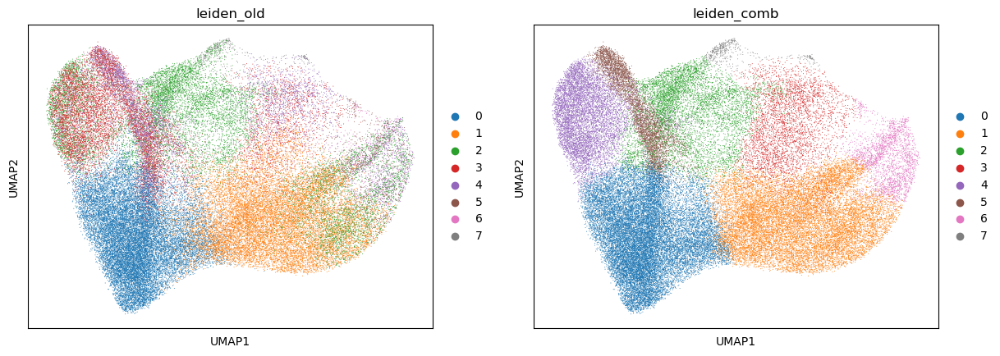

In [24]:
sc.pl.umap(adata, color = ['leiden_old', 'leiden_comb'])

In [25]:
sc.tl.leiden(adata, resolution = 0.5)

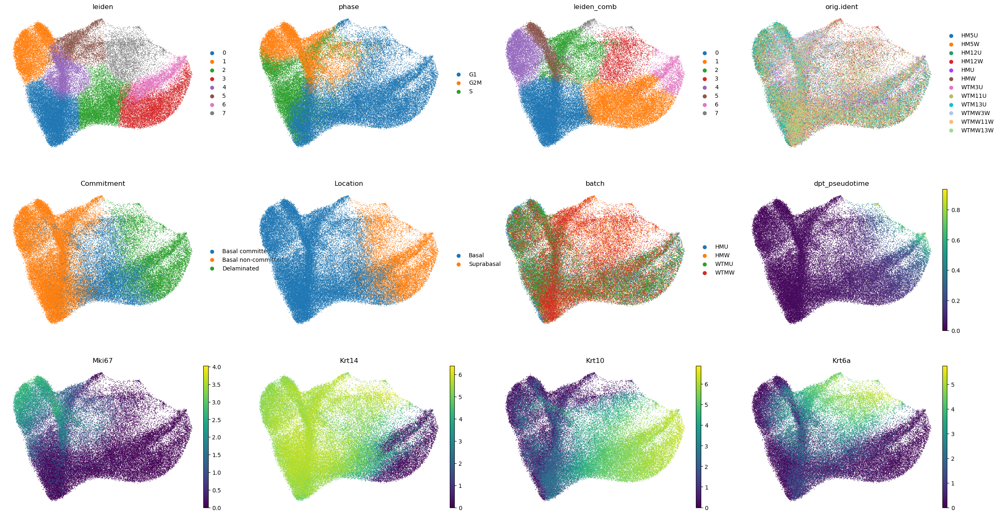

In [26]:
sc.pl.umap(adata, color = ['leiden', 'phase', 'leiden_comb', 'orig.ident','Commitment', 'Location', 'batch', 'dpt_pseudotime', 'Mki67','Krt14','Krt10','Krt6a'], s = 5, frameon = False)

In [27]:
adata.obs['Wound'] = adata.obs['Wound'].replace('nan', 'Uninjured')

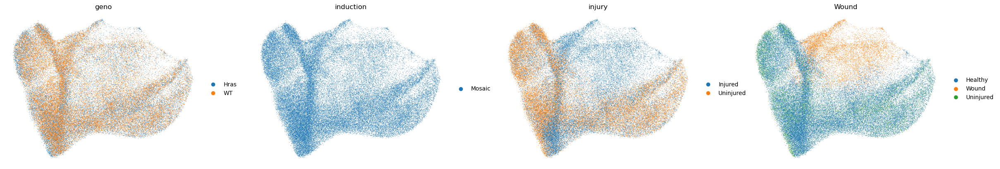

In [28]:
sc.pl.umap(adata, color = ['geno', 'induction', 'injury', 'Wound'], frameon = False)

ax = axes[ix]


/home/user/anaconda3/envs/karlpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)
/home/user/anaconda3/envs/karlpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)
/home/user/anaconda3/envs/karlpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


[<AxesSubplot:title={'center':'Wound'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'Wound'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'Wound'}, xlabel='UMAP1', ylabel='UMAP2'>]

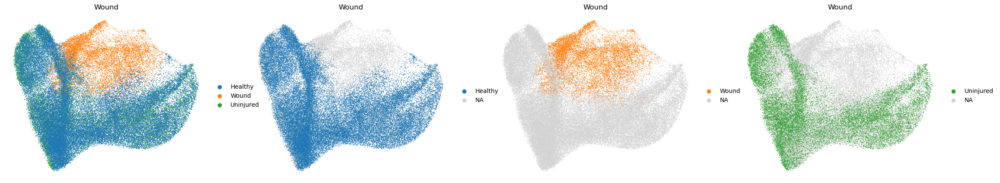

In [29]:
fig, axes = initialize_subplots(4, ncols = 4)
ax = axes[0]
sc.pl.umap(adata, color = 'Wound', s = 5, show = False, frameon = False, ax = ax)
[sc.pl.umap(adata, color = 'Wound', groups = [gr], s = 5, show = False, frameon = False, ax = axes[ix+1]) for ix, gr in enumerate(adata.obs['Wound'].cat.categories)]

In [71]:
adata.obs['Wound_comb'] = np.where(adata.obs['leiden_comb'].isin(['2','3','7']), 'Wound', 'Healthy')

ax = axes[ix]


/home/user/anaconda3/envs/karlpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)
/home/user/anaconda3/envs/karlpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)


[<AxesSubplot:title={'center':'Wound_comb'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'Wound_comb'}, xlabel='UMAP1', ylabel='UMAP2'>]

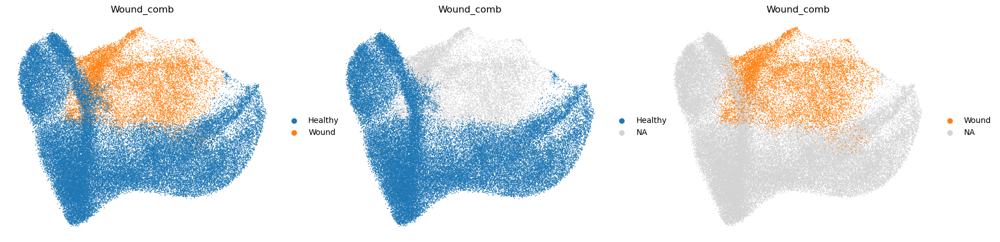

In [74]:
fig, axes = initialize_subplots(3, ncols = 3)
ax = axes[0]
sc.pl.umap(adata, color = 'Wound_comb', s = 5, show = False, frameon = False, ax = ax)
[sc.pl.umap(adata, color = 'Wound_comb', groups = [gr], s = 5, show = False, frameon = False, ax = axes[ix+1]) for ix, gr in enumerate(adata.obs['Wound_comb'].cat.categories)]

ax = axes[ix // ncols, ix % ncols]


/home/user/anaconda3/envs/karlpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)
/home/user/anaconda3/envs/karlpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)
/home/user/anaconda3/envs/karlpy/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1171: FutureWarning: Categorical.replace is deprecated and will be removed in a future version. Use Series.replace directly instead.
  values = values.replace(values.categories.difference(groups), np.nan)
/home/user/anaconda3/envs/karlpy/lib/python3.9/site-packages/scanpy/plotting/_tools/s

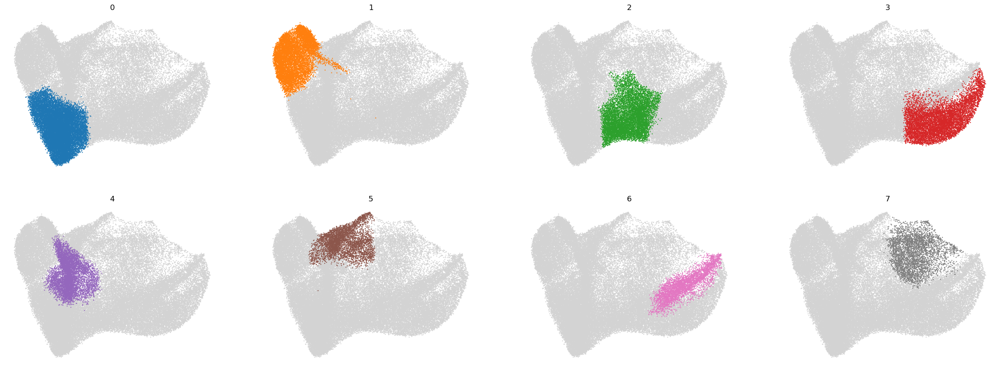

In [30]:
plots = adata.obs['leiden'].cat.categories
ncols = 4
fig, axes = initialize_subplots(len(plots), ncols = ncols)
for ix, cl in enumerate(plots):
    ax = get_ax(axes, ix, ncols)
    sc.pl.umap(adata, color = 'leiden', groups = [cl], legend_loc = '', title = cl, ax = ax, show = False, frameon = False, s = 10)

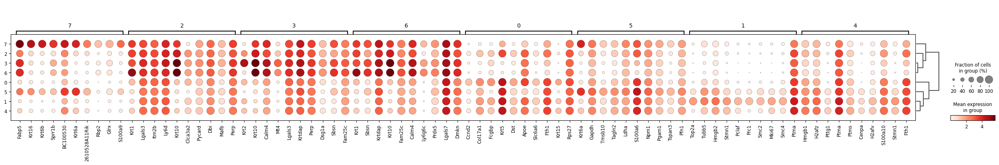

In [31]:
sc.tl.rank_genes_groups(adata, groupby = 'leiden', method = 'wilcoxon')
sc.tl.dendrogram(adata, groupby = 'leiden')
sc.pl.rank_genes_groups_dotplot(adata)

In [32]:
pd.DataFrame(adata.uns['rank_genes_groups']['names'])

,0,1,2,3,4,5,6,7
0,Ccnd2,Top2a,Krt1,Krt2,Hmgb1,Krt6a,Krt1,Fabp5
1,Col17a1,Tubb5,Lgals3,Krt10,H2afz,Gapdh,Sbsn,Krt16
2,Fcgbp,Hmgb2,Itm2b,Calm4,Pttg1,Tmsb10,Krtdap,Krt6b
3,Krt5,Stmn1,Ly6d,Mt4,Ptma,Tagln2,Krt10,Sprr1b
4,Dst,Pclaf,Krt10,Lgals3,Ptms,Ldha,Fam25c,BC100530
...,...,...,...,...,...,...,...,...
14711,Tubb4b,Krt1,Tuba1b,Col17a1,1810037I17Rik,Rora,Tspo,Ptma
14712,Gltp,Krt10,Calm2,S100a6,Lgals3,Fcgbp,Krt5,Fcgbp
14713,Lypd3,Fabp5,Hmgb2,Fth1,Krt10,Clca3a2,Fth1,Col17a1
14714,Dmkn,Lgals7,Tubb5,Krt5,Ubb,Cst3,S100a6,Apoe


# Save annotated dataset

# Read data

In [6]:
sc.logging.print_header()

scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.23.3 scipy==1.9.3 pandas==1.4.4 scikit-learn==1.1.3 statsmodels==0.13.2 python-igraph==0.9.1 pynndescent==0.5.4


In [7]:
path = '/mnt/e/IMPORTANT-Backup-Sequencing-Projects/2021-Greco-Sara-Nur-Help/Rebuttal_2022_Analysis'
adata = sc.read_h5ad(os.path.join(path, 'IFE_Combined_datasets_Annotated.h5ad'))
adata.raw = sc.pp.log1p(sc.read_loom(os.path.join(path, 'IFE_Combined_datasets.loom'), validate = False)[adata.obs_names], copy = True)

In [14]:
sample = {'HMU': 'HMU',
          'HM5U': 'HMU', 
          'HM12U': 'HMU',
          'HM5W': 'HMW',
          'HM12W': 'HMW', 
          'HMW': 'HMW', 
          'WTM3U': 'WTMU', 
          'WTM11U': 'WTMU', 
          'WTM13U': 'WTMU',
          'WTMW3W': 'WTMW', 
          'WTMW11W': 'WTMW', 
          'WTMW13W': 'WTMW'}

In [13]:
ras_map = {'HMW': 'Hras', 'HMU': 'Hras', 'WTMW': 'WT', 'WTMU': 'WT'}
adata.obs['Hras'] = adata.obs['batch'].map(ras_map).copy()
#adata.uns['Hras_colors'] = ['#949494', '#3931de']

In [111]:
adata.obs['Tomato_class2'] = adata.obs['Tomato_class'].map({'Tom+': 'tdTomato +', 'Tom dim': 'tdTomato -', 'Tom-': 'tdTomato -'})
tom_cmap = {'tdTomato +': 'tomato', 'tdTomato -': 'darkgreen'}

mouseID = {b: (['Mouse1', 'Mouse2', 'Mouse3']*4)[ix] for ix, b in enumerate(['HMU', 'HM5U', 'HM12U', 'HMW', 'HM5W', 'HM12W', 'WTM3U', 'WTM11U', 'WTM13U', 'WTMW3W', 'WTMW11W', 'WTMW13W'])}
adata.obs['mouseID'] = adata.obs['orig.ident'].map(mouseID)

batch_names = {'WTMU': 'Uninjured-wild-type-mosaic', 'HMU': 'Uninjured-Hras-mosaix', 'WTMW': 'Injured-wild-type-mosaic','HMW': 'Injured-Hras-mosaic'}

leiden_reorder = {'0': '2', '1': '6', '2': '3', '3': '5', '4': '0', '5': '1', '6': '7', '7': '4'}
adata.obs['leiden_reordered'] = adata.obs['leiden_comb'].map(leiden_reorder).astype(str).astype('category')

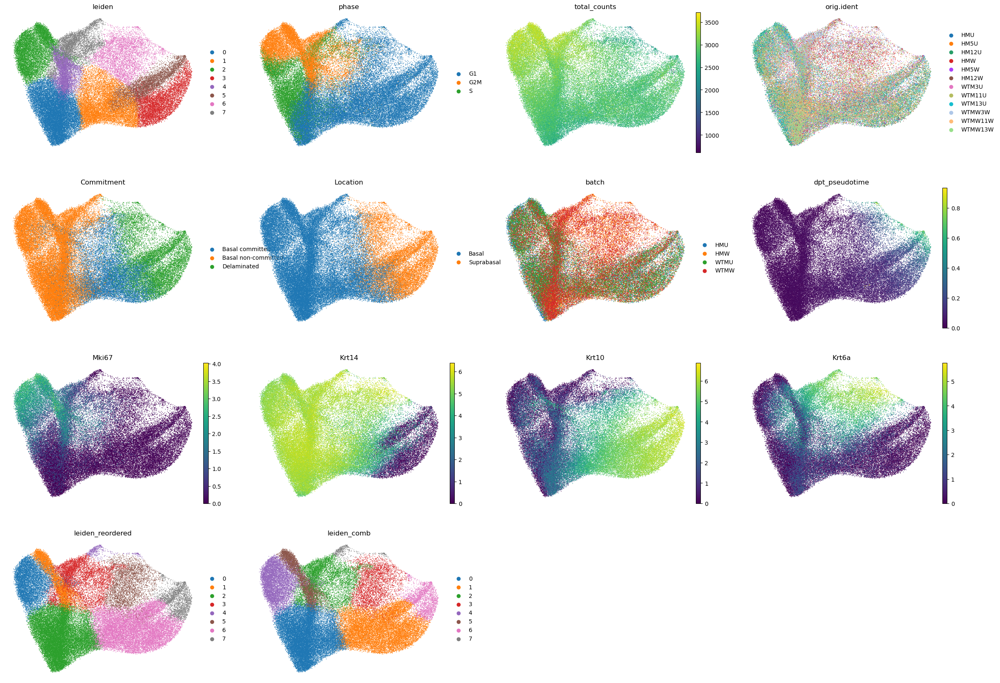

In [63]:
sc.pl.umap(adata, color = ['leiden', 'phase', 'total_counts', 'orig.ident','Commitment', 'Location', 'batch', 'dpt_pseudotime', 'Mki67','Krt14','Krt10','Krt6a', 'leiden_reordered','leiden_comb'], s = 5, frameon = False)

# Plots for figures

## Fig S4h

ax = axes[ix]


/home/user/anaconda3/envs/karlpy/lib/python3.9/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/home/user/anaconda3/envs/karlpy/lib/python3.9/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


<AxesSubplot:xlabel='UMAP1', ylabel='UMAP2'>

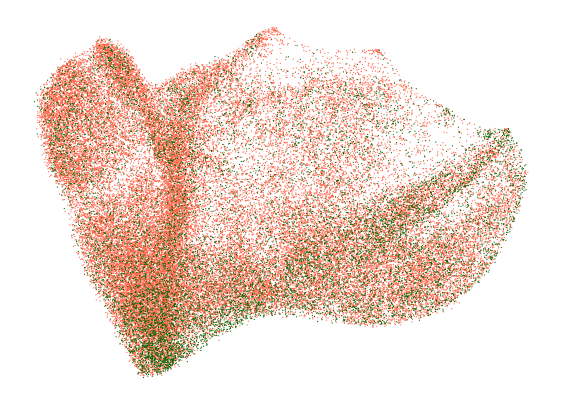

In [10]:
adata.obs['Tomato_class2'] = adata.obs['Tomato_class'].map({'Tom+': 'tdTomato +', 'Tom dim': 'tdTomato -', 'Tom-': 'tdTomato -'})
tom_cmap = {'tdTomato +': 'tomato', 'tdTomato -': 'darkgreen'}

color = 'Tomato_class2'
fig, ax = initialize_subplots(1,1)
sc.pl.umap(adata[adata.obs[color]=='tdTomato +'], color = color, s = 3, frameon = False, ax = ax, show = False, palette = tom_cmap, title = '', legend_loc = '', linewidth = 0)
sc.pl.umap(adata[adata.obs[color]=='tdTomato -'], color = color, s = 3, frameon = False, ax = ax, show = False, palette = tom_cmap, title = '', legend_loc = '', linewidth = 0)
#[fig.savefig(os.path.join(path, 'Figs', f'IFE_UMAP_{color}.{f}'), bbox_inches = 'tight') for f in ['png','pdf']]

## Fig S4g

ax = axes[ix]


<AxesSubplot:xlabel='UMAP1', ylabel='UMAP2'>

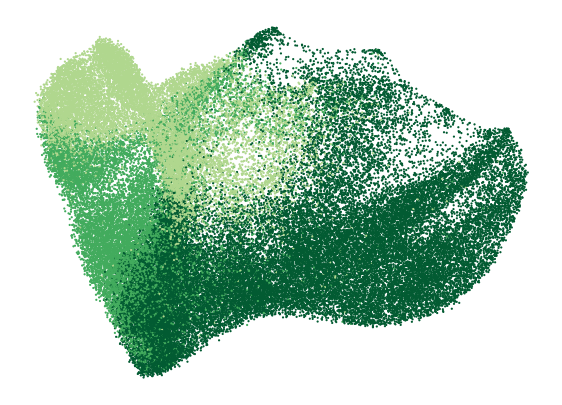

In [11]:
color = 'phase'
phase_cmap = {'G1': '#025B32', 'S': '#42AB5D', 'G2M': '#B0D78E'}
fig, ax = initialize_subplots(1,1)
sc.pl.umap(adata, color = color, s = 10, frameon = False, ax = ax, show = False, palette = phase_cmap, title = '', legend_loc = '')
#[fig.savefig(os.path.join(fig_path, f'IFE_UMAP_{color}.{f}'), bbox_inches = 'tight') for f in ['png','pdf']]

## Fig S4f

ax = axes[ix]


<AxesSubplot:xlabel='UMAP1', ylabel='UMAP2'>

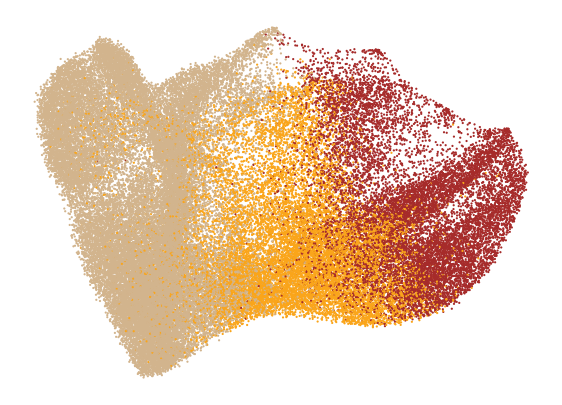

In [12]:
color = 'Commitment'
commitment_cmap = {'Basal committed': '#FAA51A', 'Basal non-committed': '#D2B48D', 'Delaminated': '#A62B2A'}
fig, ax = initialize_subplots(1,1)
sc.pl.umap(adata, color = color, s = 10, frameon = False, ax = ax, show = False, palette = commitment_cmap, title = '', legend_loc = '')
#[fig.savefig(os.path.join(fig_path, f'IFE_UMAP_{color}.{f}'), bbox_inches = 'tight') for f in ['png','pdf']]

## Fig 3i

ax = axes[ix]


<AxesSubplot:xlabel='UMAP1', ylabel='UMAP2'>

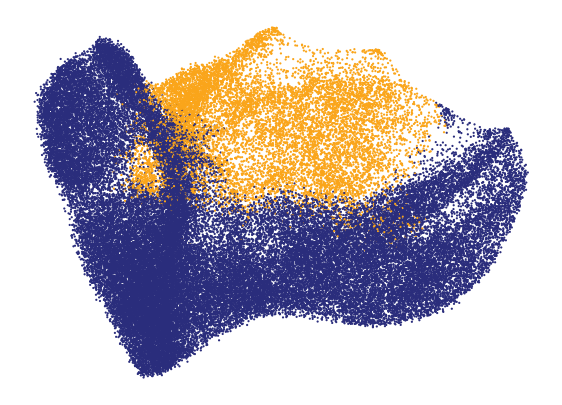

In [15]:
color = 'Wound_comb'
wound_cmap = {'Healthy': '#2A2D7C', 'Wound': '#FAA51A'}
fig, ax = initialize_subplots(1,1)
sc.pl.umap(adata, color = color, s = 10, frameon = False, ax = ax, show = False, palette = wound_cmap, title = '', legend_loc = '')
#[fig.savefig(os.path.join(fig_path, f'IFE_UMAP_{color}.{f}'), bbox_inches = 'tight') for f in ['png','pdf']]

## Fig 3j

In [23]:
tmp = adata[adata.obs['Commitment']!='Delaminated'].obs.copy()

In [24]:
hf = tmp[(tmp['Wound_comb']=='Healthy') & (tmp['Tomato_class2'] == 'tdTomato +')]
hf = hf.groupby('orig.ident', observed = True)['Commitment'].value_counts(normalize = True)*100
hf = hf.reset_index()
hf.columns = ['orig.ident', 'Commitment', 'Perc']
hf['batch'] = hf['orig.ident'].map(sample)
hf

,orig.ident,Commitment,Perc,batch
0,HMU,Basal non-committed,63.341646,HMU
1,HMU,Basal committed,36.658354,HMU
2,HM5U,Basal non-committed,75.820685,HMU
3,HM5U,Basal committed,24.179315,HMU
4,HM12U,Basal non-committed,79.469305,HMU
5,HM12U,Basal committed,20.530695,HMU
6,HM5W,Basal non-committed,73.989713,HMW
7,HM5W,Basal committed,26.010287,HMW
8,HM12W,Basal non-committed,68.031052,HMW
9,HM12W,Basal committed,31.968948,HMW


In [25]:
wf = tmp[(tmp['Wound_comb']=='Wound') & (tmp['batch'].isin(['WTMW','HMW'])) & (tmp['Tomato_class2'] == 'tdTomato +')]
wf = wf.groupby('orig.ident', observed = True)['Commitment'].value_counts(normalize = True)*100
wf = wf.reset_index()
wf.columns = ['orig.ident', 'Commitment', 'Perc']
wf['batch'] = wf['orig.ident'].map(sample)
wf

,orig.ident,Commitment,Perc,batch
0,HM5W,Basal committed,63.740458,HMW
1,HM5W,Basal non-committed,36.259542,HMW
2,HM12W,Basal non-committed,61.919040,HMW
3,HM12W,Basal committed,38.080960,HMW
4,HMW,Basal non-committed,62.242867,HMW
5,HMW,Basal committed,37.757133,HMW
6,WTMW3W,Basal non-committed,66.914104,WTMW
7,WTMW3W,Basal committed,33.085896,WTMW
8,WTMW11W,Basal non-committed,60.158730,WTMW
9,WTMW11W,Basal committed,39.841270,WTMW


In [26]:
hf['Hras'] = hf['batch'].map(ras_map)
wf['Hras'] = wf['batch'].map(ras_map)

In [27]:
u_bc_h = hf[(hf['Commitment']=='Basal committed') & (hf['Hras']=='Hras')]['Perc'].values
u_bc_w = hf[(hf['Commitment']=='Basal committed') & (hf['Hras']=='WT')]['Perc'].values

i_bc_h = wf[(wf['Commitment']=='Basal committed') & (wf['Hras']=='Hras')]['Perc'].values
i_bc_w = wf[(wf['Commitment']=='Basal committed') & (wf['Hras']=='WT')]['Perc'].values

In [28]:
comparisons = [[u_bc_h, u_bc_w], [i_bc_h, i_bc_w], [u_bc_h, i_bc_h], [u_bc_w, i_bc_w]]
names = ['Healthy', 'Wound', 'H-v-W_Hras', 'H-v-W_WT']
res = {}
for ix, comp in enumerate(comparisons):
    stat, p = scipy.stats.ttest_ind(a = comp[0], b = comp[1], alternative = 'less')
    res[names[ix]] = p
    print(names[ix], p)

Healthy 0.7209703888745227
Wound 0.7080932686577943
H-v-W_Hras 0.025668424222194633
H-v-W_WT 0.004189225363961377


In [32]:
import statsmodels.api as sm
import statsmodels as sm
pvals = [0.004189, 0.025668]
adj_pvals = sm.stats.multitest.multipletests(pvals, alpha = 0.05)[1]
[float(x) for x in adj_pvals]

[0.008360452279, 0.025668]

ax = axes[ix]


/home/user/anaconda3/envs/karlpy/lib/python3.9/site-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:k'` for same effect.
  warnings.warn(msg, FutureWarning)
/home/user/anaconda3/envs/karlpy/lib/python3.9/site-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:k'` for same effect.
  warnings.warn(msg, FutureWarning)


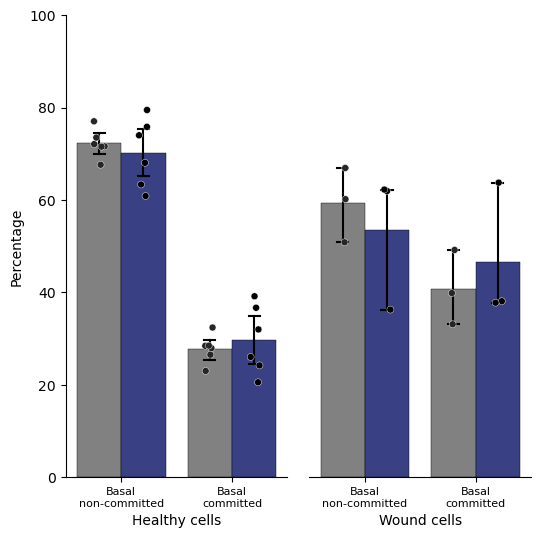

In [29]:
cmap = ['#818181', '#2D368F']

fig, axes = initialize_subplots(2, 2, sharey = False, gridspec_kw = {'wspace':0.1}, figsize_multiplier = (3, 6))
x = 'Commitment'
hue = 'Hras'

s = 5
linewidth = 0.3
edgecolor = 'white'
color = 'k'
errwidth=1.5
capsize=0.1
baredge = 'k'
errcolor = 'k'

hue_order = ['Basal non-committed', 'Basal committed']
order = ['WT', 'Hras']

group = 'Healthy cells'
ax = axes[0]
sbn.barplot(data = hf, x = x, y = 'Perc', hue = hue,order = hue_order, ax = ax, palette = cmap, hue_order = order, errwidth = errwidth, capsize = capsize, linewidth = linewidth, edgecolor=baredge, errcolor = errcolor)
sbn.stripplot(data = hf, x = x, y = 'Perc', hue = hue, dodge = 0.25, order = hue_order, color = color, ax = ax, hue_order = order, s = s, linewidth = linewidth, edgecolor = edgecolor)
ax.set_xlabel(group)
ax.set_ylabel('Percentage')

ax.legend('', frameon = False)

group = 'Wound cells'
ax = axes[1]
sbn.barplot(data = wf, x = x, y = 'Perc', hue = hue,order = hue_order, ax = ax, palette = cmap, hue_order = order, errwidth = errwidth, capsize = capsize, linewidth = linewidth, edgecolor=baredge, errcolor = errcolor)
handles, labels = ax.get_legend_handles_labels()
sbn.stripplot(data = wf, x = x, y = 'Perc', hue = hue, dodge = 0.25, order = hue_order, color = color, ax = ax, hue_order = order, s = s, linewidth = linewidth, edgecolor = edgecolor)
ax.set_xlabel(group)
#ax.legend(handles = handles, labels = labels, frameon = False, bbox_to_anchor = (1.6,1))
ax.legend('', frameon = False)
ax.set_ylabel('')
ax.spines['left'].set_visible(False)
ax.set_yticks([])

for ax in axes:
    ax.set_ylim([0, 100])
    #ax.set_xlabel('')
    #ax.set_xticklabels(ax.get_xticklabels(), rotation = 45, ha = 'right')
    ax.set_xticklabels(['\n'.join(x.get_text().split(' ')) for x in ax.get_xticklabels()], rotation = 0, ha = 'center', fontsize = 8)
    [ax.spines[spine].set_visible(False) for spine in ['top','right']]

#[ax.axes.grid('on', zorder = -10, axis = 'y', ls = ':') for ax in axes]
#fig.suptitle('Tomato+ cells')

#[fig.savefig(os.path.join(path, 'Figs', f'IFE_Barplot_Commitment_Proportions_Tomato-pos.{f}'), bbox_inches = 'tight') for f in ['pdf', 'png']]

## Fig 3k

ax = axes[ix // ncols, ix % ncols]


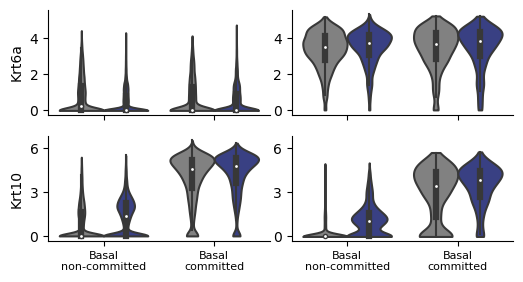

In [34]:
genes = ['Krt6a','Krt10']

cmap = ['#818181', '#2D368F']

df = adata.obs.copy()
df[genes] = adata[:, genes].X
df = df[(df['Commitment']!='Delaminated') & (df['Tomato_class']=='Tom+')]
df['Comb'] = df['Hras'].astype(str) +' '+ df['Commitment'].astype(str)

hue_order = ['Basal non-committed', 'Basal committed']
order = ['WT','Hras']

ncols =2
fig, axes = initialize_subplots(len(genes)*2, ncols = ncols, figsize_multiplier=(3, 1.5), sharex = True, gridspec_kw = {'wspace': 0.1})
ax_ix = 0
for ix, g in enumerate(genes):
    top = 0
    for h_ix, w in enumerate(['Healthy', 'Wound']):
        ax = axes.flatten()[ax_ix]
        sbn.violinplot(data = df[df['Wound_comb'] == w], x = 'Commitment', hue = 'Hras', y = g, cut = 0, ax = ax, order = hue_order, hue_order = order, scale = 'width', inner = 'box', palette= cmap)
        if all([ix == 0, h_ix == 1]):
            #ax.legend(bbox_to_anchor = (1,1), frameon = False)
            ax.legend([], frameon = False)
        else:
            ax.legend([], frameon = False)
        
        ylim = ax.get_ylim()
        if ylim[1] > top:
            top = ylim[1]
        
        if h_ix == 1:
            ax.set_ylabel('')
            #ax.spines['left'].set_visible(False)
            ax.set_yticks([])
            ax.set_ylim(top = top)
            axes.flatten()[ax_ix-1].set_ylim(top = top)
        
        ax.set_xlabel('')
        [ax.spines[spine].set_visible(False) for spine in ['top','right']]
        ax.set_xticklabels(['\n'.join(x.get_text().split(' ')) for x in ax.get_xticklabels()], rotation = 0, ha = 'center', fontsize = 8)
        
        ax.yaxis.set_major_locator(MaxNLocator(integer = True, nbins = 3))
        ax_ix+=1
        
#[fig.savefig(os.path.join(path, 'Figs', f'IFE_Violinplot_Commitment_Proportions_Tomato-pos.{f}'), bbox_inches = 'tight') for f in ['pdf', 'png']]

## Fig 3g

In [35]:
leiden_reorder = {'0': '2', '1': '6', '2': '3', '3': '5', '4': '0', '5': '1', '6': '7', '7': '4'}
adata.obs['leiden_reordered'] = adata.obs['leiden_comb'].map(leiden_reorder).astype(str).astype('category')

ax = axes[ix]


<AxesSubplot:title={'center':'leiden_reordered'}, xlabel='UMAP1', ylabel='UMAP2'>

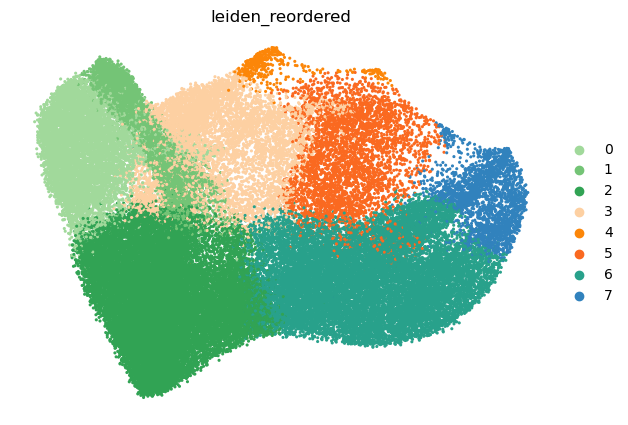

In [36]:
leiden_cmap = {'0': '#a1d99b',
     '1': '#74c476',
     '2': '#31a354',
     '3': '#fdd0a2',
     '4': '#fc8608', 
     '5': '#fa6920', 
     '6': '#28a18b',
     '7': '#3182bd'}

fig, ax = initialize_subplots(1,1)

sc.pl.umap(adata, color = 'leiden_reordered', palette = leiden_cmap, s = 20, ax = ax, show = False, frameon = False)
#[fig.savefig(os.path.join(path, 'Figs', f'IFE_UMAP_Leiden.{f}'), bbox_inches = 'tight') for f in ['pdf', 'png']]

## Fig 3h

ax = axes[ix // ncols, ix % ncols]


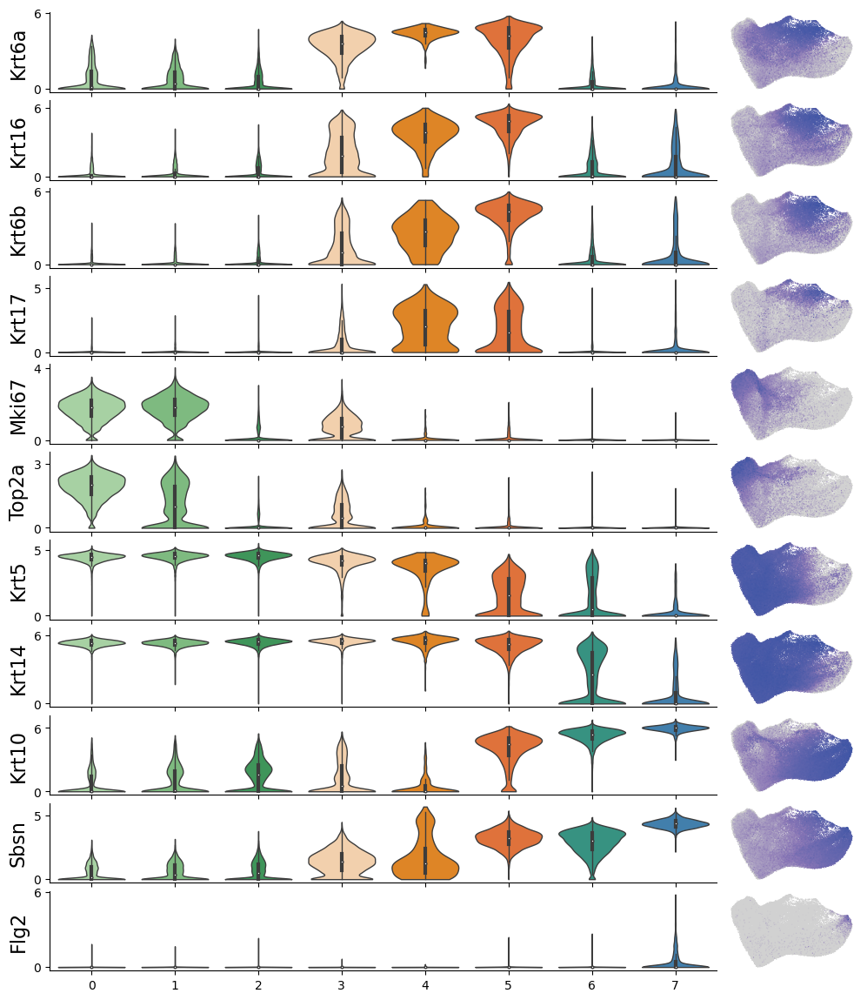

In [38]:
norm = mpl.colors.Normalize(-1,1)
colors = [[norm(-1.0), "#D1D1D1"],
          [norm(0), "#8C78B7"],
          [norm( 1.0), "#3953A4"]]
cmap = mpl.colors.LinearSegmentedColormap.from_list("", colors)


genes = ['Krt6a', 'Krt16', 'Krt6b','Krt17','Mki67', 'Top2a', 'Krt5', 'Krt14','Krt10', 'Sbsn','Flg2']
cluster = 'leiden_reordered'
df = adata.obs[[cluster]].copy()
df[genes] = adata[:, genes].X

ncols = 2
fig, axes = initialize_subplots(len(genes)*ncols, ncols, figsize_multiplier=(6, 1.3), sharex = 'col', gridspec_kw = {'hspace':0.1, 'width_ratios': [5,1], 'wspace':0.02})
for ix, g in enumerate(genes):
    ax = axes[ix, 0]
    sbn.violinplot(data = df, x = cluster, y = g, ax = ax, scale = 'width', cut = 0, inner = 'box', linewidth = 1, palette = leiden_cmap)
    ax.set_xlabel('')
    [ax.spines[spine].set_visible(False) for spine in ['top', 'right']]
    ax.yaxis.set_major_locator(MaxNLocator(integer = True, nbins = 1, min_n_ticks = 2))
    ax.set_ylabel(g, fontsize = 16)
    
    ax = axes[ix, 1]
    sc.pl.umap(adata, color = g, s = 3, frameon = False, ax = ax, show = False, cmap = cmap, title = '')
    cbar = ax.collections[0].colorbar.remove()

#[fig.savefig(os.path.join(path, 'Figs', f'IFE_Violin-UMAP_genes.{f}'), bbox_inches = 'tight') for f in ['pdf', 'png']]

## Fig s4c

In [39]:
batch_names = {'WTMU': 'Uninjured-wild-type-mosaic', 'HMU': 'Uninjured-Hras-mosaic', 'WTMW': 'Injured-wild-type-mosaic','HMW': 'Injured-Hras-mosaic'}

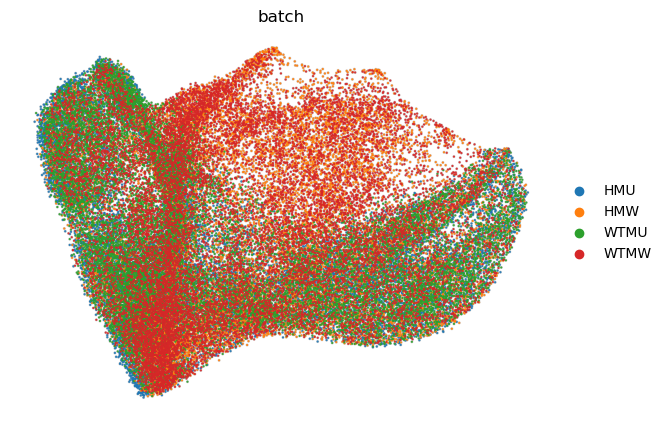

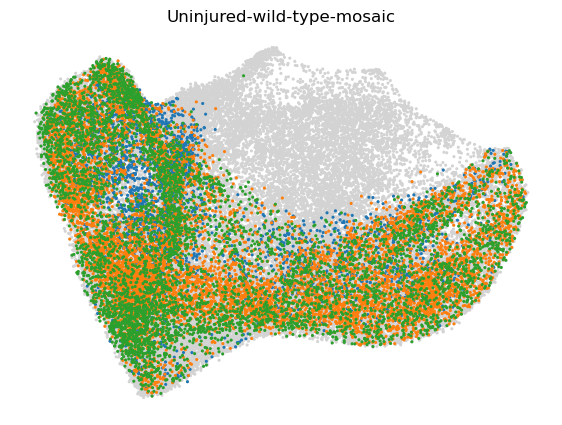

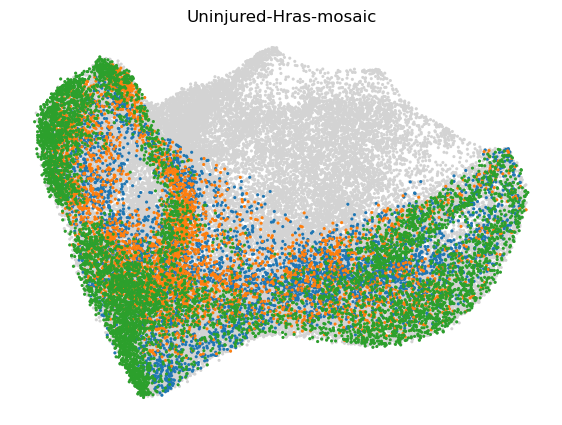

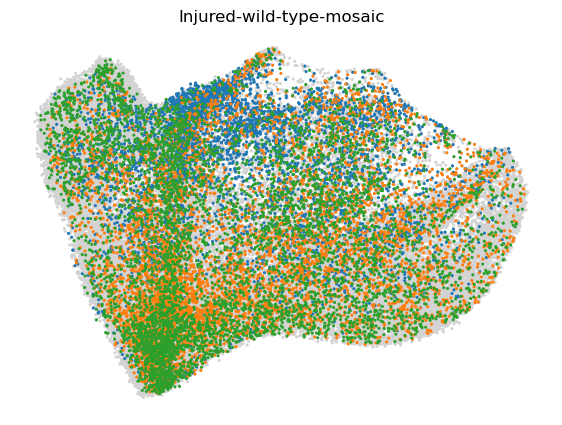

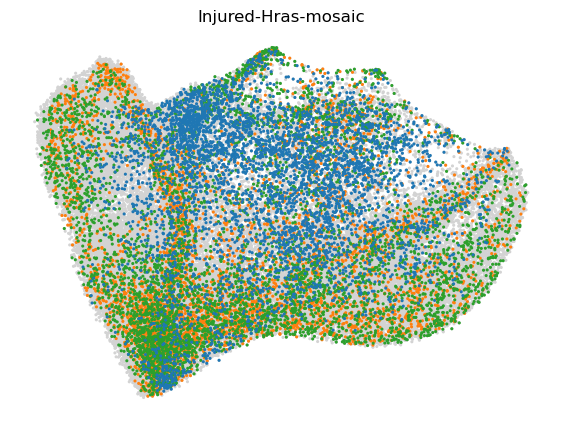

In [40]:
plots = adata.obs['batch'].cat.categories
ncols = 5

#fig, axes = initialize_subplots(len(plots)+1, ncols = ncols)

#sc.pl.umap(adata, color = 'batch', ax = axes[0], show = False, frameon = False, s = 10, alpha = 0.9)

for ix, b in enumerate(['ALL', 'WTMU', 'HMU', 'WTMW','HMW']):
    #ax = get_ax(axes, ix+1, ncols)
    fig, ax = initialize_subplots(1, ncols = 1)
    sc.pl.umap(adata, ax = ax, show = False, frameon=False, s = 20)
    
    if b == 'ALL':
        sc.pl.umap(adata, color = 'batch', ax = ax, show = False, frameon = False, s = 10, alpha = 0.9)
    else:
        sc.pl.umap(adata[adata.obs['batch']==b], color = 'mouseID', ax = ax, show = False, frameon = False, s = 20, title = batch_names[b], legend_loc = '')
    
    #[fig.savefig(os.path.join(path, 'Figs', f'IFE_UMAP_batches_{b}.{f}'), bbox_inches = 'tight') for f in ['png','pdf']]
clear_output()

# EGFR ligands

## Fig S7g

### All combined

ax = axes[ix]


[None, None]

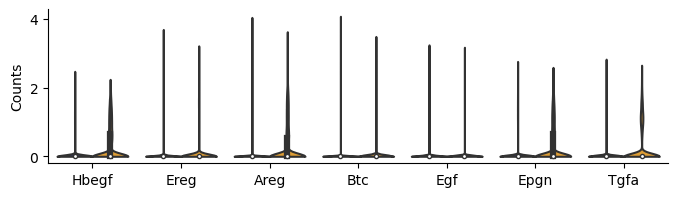

In [130]:
fontsize = 12
#genes = ['Egf', 'Areg', 'Tgfa', 'Epgn', 'Hbegf', 'Btc', 'Ereg', 'Fgf7','Wnt5a','Wnt5b','Hgf','Tgfb1','Tgfb2','Bmp1','Bmp7','Igf1']
#genes = natsorted(genes)
genes = ['Hbegf', 'Ereg', 'Areg', 'Btc', 'Egf', 'Epgn', 'Tgfa']

cmap = {'Healthy': '#2A2D7C',
        'Wound': '#FAA51A'}

comparison = 'Wound_comb'
groups = 'leiden_comb'

cols = ['names','scores','pvals','pvals_adj','logfoldchanges']

fig, ax = initialize_subplots(1, ncols = 1, figsize_multiplier=(8, 2), sharex = True, gridspec_kw = {'hspace': 0.01})

newline = '\n'
df = adata.obs[[comparison, groups]].copy()
df[genes] = adata.raw[:, genes].X.A
df = df.melt(id_vars = comparison, value_vars=genes, var_name = 'Gene',value_name = 'Counts')

sbn.violinplot(data = df, x = 'Gene', y = 'Counts', hue = comparison, cut = 0, ax = ax, inner = 'box', palette = cmap, scale = 'width')

df['Counts'] = [x + round(np.random.uniform(-0.1, 0.1), 3) if x == 0 else x for x in df['Counts']]

#ax.set_ylim(top = 4)
tick_locator = mpl.ticker.MaxNLocator(nbins=3, integer = True, min_n_ticks = 2)
ax.yaxis.set_major_locator(tick_locator)
ax.set_xlabel('')
#ax.legend(bbox_to_anchor = (1.15,1))
ax.legend('', frameon = False)
[ax.spines[spine].set_visible(False) for spine in ['top', 'right']]

#[fig.savefig(os.path.join(path, 'Figs', f'EPI_Violinplot_Combined_Ligands_boxplot.{f}'), bbox_inches = 'tight') for f in ['pdf','png']]

In [44]:
df_ = adata.obs.copy()
df_[genes] = adata.raw[:, genes].X.A

res = {}
for g in genes:
    df = df_.groupby(['Wound_comb', 'orig.ident'])[g].mean()
    df = df.reset_index().pivot(index = 'Wound_comb', columns = 'orig.ident')
    df.columns = df.columns.droplevel(0)
    w = df[[c for c in df.columns if c.endswith('W')]].loc['Wound'].dropna().values
    h = df.loc['Healthy'].dropna().values
    stat, p = scipy.stats.ttest_ind(h, w)
    if p > 0.05:
        res[g] = np.round(p, decimals=3)
    else:
        res[g] = float(f'{p:.2e}')
res

{'Hbegf': 2.16e-05,
 'Ereg': 3.5e-05,
 'Areg': 6.06e-06,
 'Btc': 3.29e-07,
 'Egf': 0.483,
 'Epgn': 8e-05,
 'Tgfa': 1.92e-07}

In [45]:
pvals = [2.16e-5, 3.5e-5, 6.06e-6, 3.29e-7, 0.483, 8e-5, 1.92e-7]
adj_pvals = sm.stats.multitest.multipletests(pvals, alpha = 0.05)[1]
[float(x) for x in adj_pvals]

[8.639720068031056e-05,
 0.00010499632504287499,
 3.0299632766225443e-05,
 1.9739983763857122e-06,
 0.483,
 0.0001599936,
 1.3439992258562476e-06]

### WT mosaic

ax = axes[ix]


Text(0, 0.5, 'WT_Mosaic')

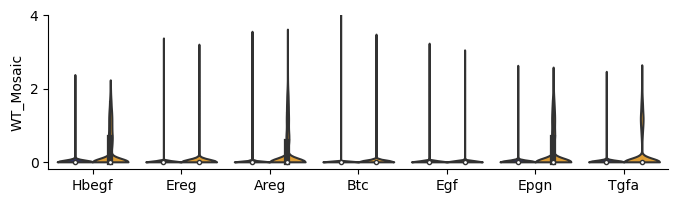

In [46]:
fontsize = 12
#genes = ['Egf', 'Areg', 'Tgfa', 'Epgn', 'Hbegf', 'Btc', 'Ereg', 'Fgf7','Wnt5a','Wnt5b','Hgf','Tgfb1','Tgfb2','Bmp1','Bmp7','Igf1']
#genes = natsorted(genes)
genes = ['Hbegf', 'Ereg', 'Areg', 'Btc', 'Egf', 'Epgn', 'Tgfa']

comp = ['WT', 'Mosaic']

cmap = {'Healthy': '#2A2D7C',
        'Wound': '#FAA51A'}

comparison = 'Wound_comb'
groups = 'leiden_named'

cols = ['names','scores','pvals','pvals_adj','logfoldchanges']

fig, ax = initialize_subplots(1, ncols = 1, figsize_multiplier=(8, 2), sharex = True, gridspec_kw = {'hspace': 0.01})

newline = '\n'
df = adata.obs.copy()
df[genes] = adata.raw[:, genes].X.A
df = df[(df['Hras']==comp[0]) & (df['induction']==comp[1])]
df = df.melt(id_vars = comparison, value_vars=genes, var_name = 'Gene',value_name = 'Counts')

sbn.violinplot(data = df, x = 'Gene', y = 'Counts', hue = comparison, cut = 0, ax = ax, inner = 'box', palette = cmap, scale = 'width')

df['Counts'] = [x + round(np.random.uniform(-0.1, 0.1), 3) if x == 0 else x for x in df['Counts']]

ax.set_ylim(top = 4)
tick_locator = mpl.ticker.MaxNLocator(nbins=3, integer = True, min_n_ticks = 2)
ax.yaxis.set_major_locator(tick_locator)
ax.set_xlabel('')
#ax.legend(bbox_to_anchor = (1.15,1))
ax.legend('', frameon = False)
[ax.spines[spine].set_visible(False) for spine in ['top', 'right']]
ax.set_ylabel(f'{comp[0]}_{comp[1]}')

#[fig.savefig(os.path.join(path, 'Figs', f'EPI_Violinplot_{comp[0]}_{comp[1]}_Ligands_boxplot.{f}'), bbox_inches = 'tight') for f in ['pdf','png']]

In [47]:
df_ = adata.obs.copy()
df_[genes] = adata.raw[:, genes].X.A
df_ = df_[(df_['Hras']==comp[0]) & (df_['induction']==comp[1])]

res = {}
for g in genes:
    df = df_.groupby(['Wound_comb', 'orig.ident'])[g].mean()
    df = df.reset_index().pivot(index = 'Wound_comb', columns = 'orig.ident')
    df.columns = df.columns.droplevel(0)
    w = df[[c for c in df.columns if c.endswith('W')]].loc['Wound'].dropna().values
    h = df.loc['Healthy'].dropna().values
    stat, p = scipy.stats.ttest_ind(h, w)
    if p > 0.05:
        res[g] = np.round(p, decimals=3)
    else:
        res[g] = float(f'{p:.2e}')
print(f'{comp[0]} {comp[1]}')
res

WT Mosaic


{'Hbegf': 0.000311,
 'Ereg': 4.86e-05,
 'Areg': 0.00035,
 'Btc': 0.0085,
 'Egf': 0.42,
 'Epgn': 0.00282,
 'Tgfa': 9.91e-05}

In [48]:
pvals = [0.000311, 4.86e-5, 0.00035, 0.0085, 0.42, 0.00282, 9.91e-5]
adj_pvals = sm.stats.multitest.multipletests(pvals, alpha = 0.05)[1]
[float(x) for x in adj_pvals]

[0.0015540330907555383,
 0.0003401504028574987,
 0.0015540330907555383,
 0.016927750000000002,
 0.42,
 0.008436165225768,
 0.0005944527073133987]

### Hras mosaic

ax = axes[ix]


Text(0, 0.5, 'Hras_Mosaic')

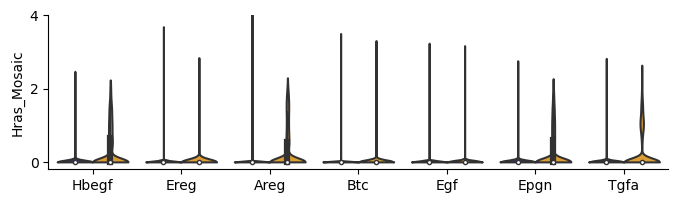

In [49]:
fontsize = 12
genes = ['Hbegf', 'Ereg', 'Areg', 'Btc', 'Egf', 'Epgn', 'Tgfa']

comp = ['Hras', 'Mosaic']

cmap = {'Healthy': '#2A2D7C',
        'Wound': '#FAA51A'}

comparison = 'Wound_comb'
groups = 'leiden_named'

cols = ['names','scores','pvals','pvals_adj','logfoldchanges']

fig, ax = initialize_subplots(1, ncols = 1, figsize_multiplier=(8, 2), sharex = True, gridspec_kw = {'hspace': 0.01})

newline = '\n'
df = adata.obs.copy()
df[genes] = adata.raw[:, genes].X.A
df = df[(df['Hras']==comp[0]) & (df['induction']==comp[1])]
df = df.melt(id_vars = comparison, value_vars=genes, var_name = 'Gene',value_name = 'Counts')

sbn.violinplot(data = df, x = 'Gene', y = 'Counts', hue = comparison, cut = 0, ax = ax, inner = 'box', palette = cmap, scale = 'width')

df['Counts'] = [x + round(np.random.uniform(-0.1, 0.1), 3) if x == 0 else x for x in df['Counts']]

ax.set_ylim(top = 4)
tick_locator = mpl.ticker.MaxNLocator(nbins=3, integer = True, min_n_ticks = 2)
ax.yaxis.set_major_locator(tick_locator)
ax.set_xlabel('')
#ax.legend(bbox_to_anchor = (1.15,1))
ax.legend('', frameon = False)
[ax.spines[spine].set_visible(False) for spine in ['top', 'right']]
ax.set_ylabel(f'{comp[0]}_{comp[1]}')

#[fig.savefig(os.path.join(path, 'Figs', f'EPI_Violinplot_{comp[0]}_{comp[1]}_Ligands_boxplot.{f}'), bbox_inches = 'tight') for f in ['pdf','png']]

In [50]:
df_ = adata.obs.copy()
df_[genes] = adata.raw[:, genes].X.A
df_ = df_[(df_['Hras']==comp[0]) & (df_['induction']==comp[1])]

res = {}
for g in genes:
    df = df_.groupby(['Wound_comb', 'orig.ident'])[g].mean()
    df = df.reset_index().pivot(index = 'Wound_comb', columns = 'orig.ident')
    df.columns = df.columns.droplevel(0)
    w = df[[c for c in df.columns if c.endswith('W')]].loc['Wound'].dropna().values
    h = df.loc['Healthy'].dropna().values
    stat, p = scipy.stats.ttest_ind(h, w)
    if p > 0.05:
        res[g] = np.round(p, decimals=3)
    else:
        res[g] = float(f'{p:.2e}')
print(f'{comp[0]} {comp[1]}')
res

Hras Mosaic


{'Hbegf': 0.00601,
 'Ereg': 0.00819,
 'Areg': 0.0038,
 'Btc': 5.47e-07,
 'Egf': 0.954,
 'Epgn': 0.0169,
 'Tgfa': 0.00106}

In [51]:
pvals = [0.00601, 0.00819, 0.0038, 5.47e-7, 0.954, 0.0169, 0.00106]
adj_pvals = sm.stats.multitest.multipletests(pvals, alpha = 0.05)[1]
[float(x) for x in adj_pvals]

[0.023824146422542374,
 0.024369321053258997,
 0.018856147678224352,
 3.828993716616728e-06,
 0.954,
 0.03351439,
 0.006343169801390874]

## Score ligand expression

In [52]:
genes = ['Hbegf', 'Ereg', 'Areg', 'Btc', 'Egf', 'Epgn', 'Tgfa']
sc.tl.score_genes(adata, genes, score_name = 'Egfr_score')

/home/user/anaconda3/envs/karlpy/lib/python3.9/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


ax = axes[ix]


[None, None]

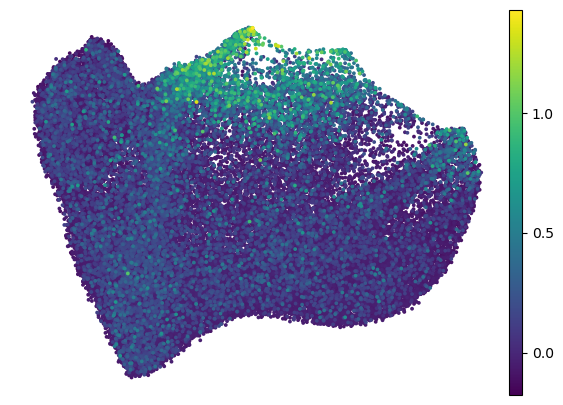

In [53]:
fig, ax = initialize_subplots(1,1)

sc.pl.umap(adata, color = 'Egfr_score', palette = leiden_cmap, s = 30, ax = ax, show = False, frameon = False, title = '')
cbar = ax.collections[0].colorbar
cbar.ax.yaxis.set_major_locator(MaxNLocator(nbins = 4, integer = False))
[fig.savefig(os.path.join(path, 'Figs', f'IFE_UMAP_EGFR_score.{f}'), bbox_inches = 'tight') for f in ['pdf', 'png']]

Text(0.5, 1.0, 'Keratinocytes')

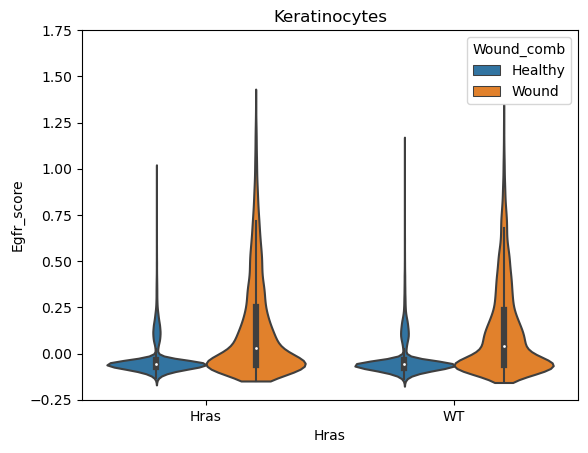

In [55]:
df = adata.obs.copy()

sbn.violinplot(data = df, x = 'Hras', y = 'Egfr_score', hue = 'Wound_comb', cut = 0, scale = 'width')
plt.ylim([-0.25, 1.75])
plt.title('Keratinocytes')

## Save the Egfr_score dataframe

Plot for Fig 5a is made in the Fibroblast analysis notebook, together with fibroblast scores

In [56]:
df.to_csv(os.path.join(path, 'Figs', f'IFE_UMAP_EGFR_score.csv'))

# GSEA volcanoplots

## Fig S4i

In [59]:
path = '/mnt/e/IMPORTANT-Backup-Sequencing-Projects/2021-Greco-Sara-Nur-Help/Rebuttal_2022_Analysis/GSEA_22112022'

date = 22112022
Tomato_class = 'Tom+'
GFP_class = 'GFP+'
commitment = ['Basal committed', 'Basal non-committed']
selection_title = f'{" + ".join(commitment) if type(commitment)==list else commitment}, {GFP_class}, {Tomato_class}'

datasets = ['HMU','WTMU']
wound = 'Healthy'
deg_df = pd.read_csv(os.path.join(path, f'{datasets[0]}_vs_{datasets[1]}_IFE_BNC_BC_{GFP_class}_{Tomato_class}_DEG_{date}.csv'), index_col = 0)

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


87

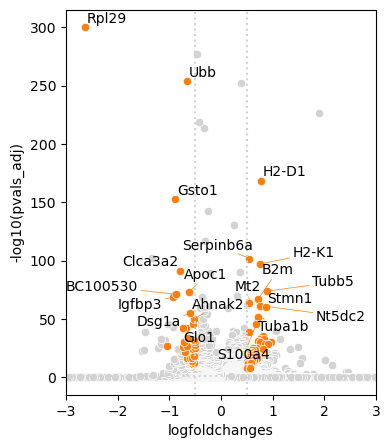

In [62]:
fig, ax = plt.subplots(figsize = (4, 5))
cmap = {'Non-DEG': 'lightgray', 'DEG':sbn.color_palette(n_colors = 2, palette = 'tab10')[1]}
#sbn.scatterplot(data = deg_df, x = 'logfoldchanges', y = '-log10(pvals_adj)', hue = 'DEG lfc:0.5', ax = ax, palette = cmap, hue_order = ['Non-DEG', 'DEG'])
sbn.scatterplot(data = deg_df[deg_df['DEG lfc:0.5']=='Non-DEG'], x = 'logfoldchanges', y = '-log10(pvals_adj)', ax = ax, c = 'lightgray')
sbn.scatterplot(data = deg_df[deg_df['DEG lfc:0.5']=='DEG'], x = 'logfoldchanges', y = '-log10(pvals_adj)', ax = ax, c = sbn.color_palette(n_colors = 2, palette = 'tab10')[1])
ax.axhline(-np.log10(0.05), ls = ':', c = 'lightgrey')
[ax.axvline(y, ls = ':', c = 'lightgrey') for y in [-0.5, 0.5]]
ax.set_xlim([-3, 3])
#ax.set_title(f'DEG volcano plot for {datasets[0]}({wound}) compared to {datasets[1]}({wound})\n{selection_title}')
if deg_df['DEG lfc:0.5'].value_counts()['DEG'] < 20:
    texts = [ax.text(x+0.01, y+0.01, s) for x, y, s in deg_df[deg_df['DEG lfc:0.5']=='DEG'][['logfoldchanges', '-log10(pvals_adj)', 'names']].values]
else:
    idxs = abs(deg_df[deg_df['DEG lfc:0.5']=='DEG']['scores']).sort_values(ascending = False).index[:20]
    texts = [ax.text(x+0.01, y+0.01, s) for x, y, s in deg_df[deg_df['DEG lfc:0.5']=='DEG'].loc[idxs][['logfoldchanges', '-log10(pvals_adj)', 'names']].values]
adjust_text(texts, arrowprops=dict(arrowstyle="-", color=cmap['DEG'], lw=0.5))

#[fig.savefig(os.path.join('/mnt/c/Users/User/Desktop/To Be Deleted/Delete me!/Sara_seq_raw_loom', 'Figs', f'DGE_Volcanoplot_{datasets[0]}_vs_{datasets[1]}_IFE_BNC_BC_{GFP_class}_{Tomato_class}_DEG_{date}.{f}'), bbox_inches = 'tight') for f in ['png','pdf']]

In [98]:
df = pd.read_csv(os.path.join(path, 'GO_Biological_Process', 'HMU_vs_WTMU_IFE_BNC_BC_GFP+_Tom+_DEG_22112022_up-regulated.csv'), index_col = 0, decimal='.')
df['-log10(Adjusted P-value)'] = -np.log10(df['Adjusted P-value'])

ax = axes[ix]


Text(0, 0.5, '')

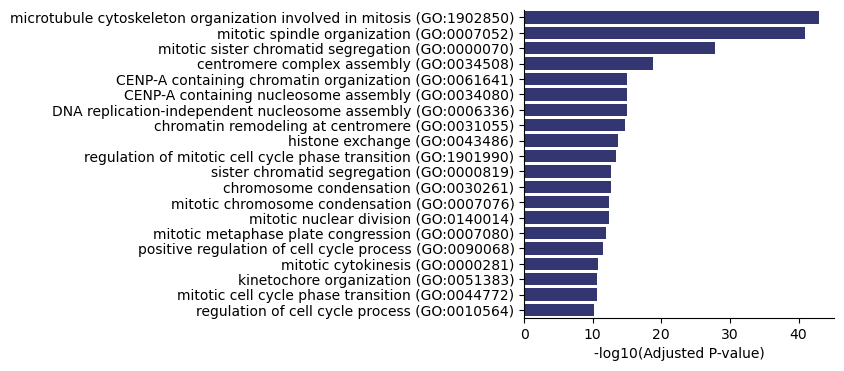

In [99]:
fig, ax = initialize_subplots(1, 1, figsize = (4, 4))
sbn.barplot(data = df.head(20), x = '-log10(Adjusted P-value)', y = 'Term', color = '#2A2D7C', ax = ax)
[ax.spines[spine].set_visible(False) for spine in ['top','right']]
ax.set_ylabel('')

#[fig.savefig(os.path.join(fig_path, f'GO_terms_HMU_vs_WTMU_IFE_BNC_BC_GFP+_Tom+_DEG_22112022_up-regulated.{f}'), bbox_inches = 'tight') for f in ['pdf','png']]



## Fig S4j

In [135]:
path = '/mnt/e/IMPORTANT-Backup-Sequencing-Projects/2021-Greco-Sara-Nur-Help/Rebuttal_2022_Analysis/GSEA_22112022'

date = 22112022
Tomato_class = 'Tom+'
GFP_class = 'GFP+'
commitment = ['Basal committed', 'Basal non-committed']
selection_title = f'{" + ".join(commitment) if type(commitment)==list else commitment}, {GFP_class}, {Tomato_class}'

datasets = ['HMW','WTMW']
wound = 'Wound'
deg_df = pd.read_csv(os.path.join(path, f'{datasets[0]}({wound})_vs_{datasets[1]}({wound})_IFE_BNC_BC_{GFP_class}_{Tomato_class}_DEG_{date}.csv'), index_col = 0)

500

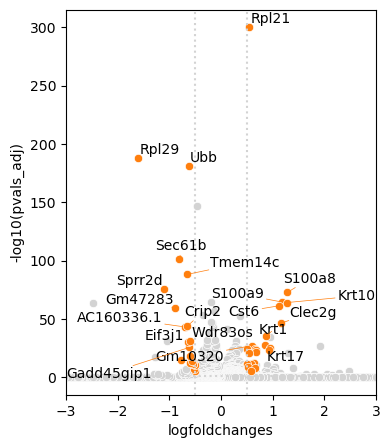

In [139]:
fig, ax = plt.subplots(figsize = (4, 5))
cmap = {'Non-DEG': 'lightgray', 'DEG':sbn.color_palette(n_colors = 2, palette = 'tab10')[1]}
#sbn.scatterplot(data = deg_df, x = 'logfoldchanges', y = '-log10(pvals_adj)', hue = 'DEG lfc:0.5', ax = ax, palette = cmap, hue_order = ['Non-DEG', 'DEG'])
sbn.scatterplot(data = deg_df[deg_df['DEG lfc:0.5']=='Non-DEG'], x = 'logfoldchanges', y = '-log10(pvals_adj)', ax = ax, c = 'lightgray')
sbn.scatterplot(data = deg_df[deg_df['DEG lfc:0.5']=='DEG'], x = 'logfoldchanges', y = '-log10(pvals_adj)', ax = ax, c = sbn.color_palette(n_colors = 2, palette = 'tab10')[1])
ax.axhline(-np.log10(0.05), ls = ':', c = 'lightgrey')
[ax.axvline(y, ls = ':', c = 'lightgrey') for y in [-0.5, 0.5]]
ax.set_xlim([-3, 3])
#ax.set_title(f'DEG volcano plot for {datasets[0]}({wound}) compared to {datasets[1]}({wound})\n{selection_title}')
if deg_df['DEG lfc:0.5'].value_counts()['DEG'] < 20:
    texts = [ax.text(x+0.01, y+0.01, s) for x, y, s in deg_df[deg_df['DEG lfc:0.5']=='DEG'][['logfoldchanges', '-log10(pvals_adj)', 'names']].values]
else:
    idxs = abs(deg_df[deg_df['DEG lfc:0.5']=='DEG']['scores']).sort_values(ascending = False).index[:20]
    texts = [ax.text(x+0.01, y+0.01, s) for x, y, s in deg_df[deg_df['DEG lfc:0.5']=='DEG'].loc[idxs][['logfoldchanges', '-log10(pvals_adj)', 'names']].values]
adjust_text(texts, arrowprops=dict(arrowstyle="-", color=cmap['DEG'], lw=0.5))

#[fig.savefig(os.path.join('/mnt/c/Users/User/Desktop/To Be Deleted/Delete me!/Sara_seq_raw_loom', 'Figs', f'DGE_Volcanoplot_{datasets[0]}({wound})_vs_{datasets[1]}({wound})_IFE_BNC_BC_{GFP_class}_{Tomato_class}_DEG_{date}.{f}'), bbox_inches = 'tight') for f in ['png','pdf']]

In [140]:
df = pd.read_csv(os.path.join(path, 'GO_Biological_Process', 'HMW(Wound)_vs_WTMW(Wound)_IFE_BNC_BC_GFP+_Tom+_DEG_22112022_up-regulated.csv'), index_col = 0, decimal='.')
df['-log10(Adjusted P-value)'] = -np.log10(df['Adjusted P-value'])

ax = axes[ix]


Text(0, 0.5, '')

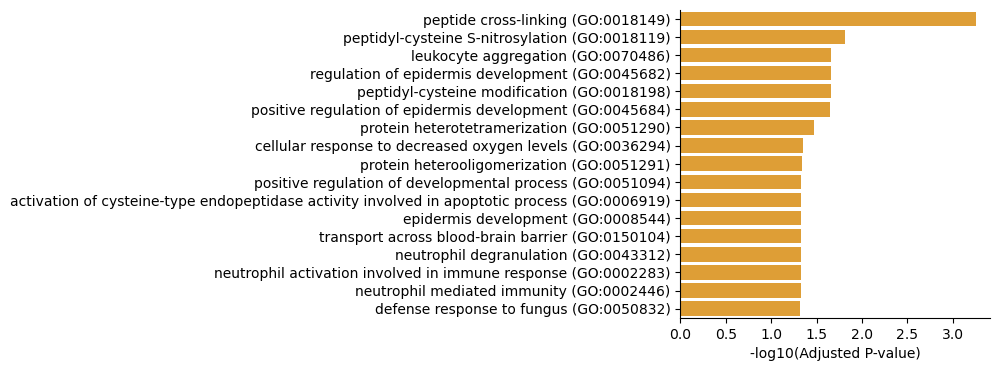

In [141]:
fig, ax = initialize_subplots(1, 1, figsize = (4, 4))
sbn.barplot(data = df.head(50)[df.head(50)['-log10(Adjusted P-value)'] >= -np.log10(0.05)], x = '-log10(Adjusted P-value)', y = 'Term', color = '#FAA51A', ax = ax)
[ax.spines[spine].set_visible(False) for spine in ['top','right']]
ax.set_ylabel('')

#[fig.savefig(os.path.join(fig_path, f'GO_terms_HMW(Wound)_vs_WTMW(Wound)_IFE_BNC_BC_GFP+_Tom+_DEG_22112022_up-regulated.{f}'), bbox_inches = 'tight') for f in ['pdf','png']]

In [142]:
date = 22112022
Tomato_class = 'Tom+'
GFP_class = 'GFP+'
commitment = ['Basal committed', 'Basal non-committed']
selection_title = f'{" + ".join(commitment) if type(commitment)==list else commitment}, {GFP_class}, {Tomato_class}'

f'{datasets[0]}_vs_{datasets[1]}_IFE_BNC_BC_{GFP_class}_{Tomato_class}_DEG_{date}.csv'

'HMW_vs_WTMW_IFE_BNC_BC_GFP+_Tom+_DEG_22112022.csv'